In [1]:
import pandas as pd

In [2]:
src_df = pd.read_csv('./data/geocohort_86533.csv')

In [3]:
# aggregate to FSA level
df = src_df.copy()
df['id'] = df['geocohort'].str.slice(0, 3)
df = df.groupby('id').aggregate({
    'bids': 'sum',
    'impressions': 'sum',
    'clicks': 'sum',
    'spend': 'sum',
}).copy().reset_index(drop=False)
df

,id,bids,impressions,clicks,spend
0,A0A,4,3,0,0.036007
1,A0G,19,16,0,0.192232
2,A1B,8,6,0,0.072112
3,A1C,1,1,0,0.012052
4,A1E,4,4,0,0.048088
...,...,...,...,...,...
794,V9S,7,6,0,0.072082
795,V9T,179,143,0,1.719232
796,V9W,58,43,0,0.517016
797,V9X,17,14,0,0.168230


In [4]:
# load FSA geojson
import geopandas as gpd

gdf = gpd.read_file('./data/fsa_ontario.geojson')
gdf = gdf.merge(df, on='id')
gdf

,id,geometry,bids,impressions,clicks,spend
0,L1G,"MULTIPOLYGON (((-78.86920 43.93540, -78.87670 ...",3210,2658,6,30.937137
1,L1H,"MULTIPOLYGON (((-78.80765 43.89346, -78.81338 ...",1439,1144,3,13.291793
2,L1J,"MULTIPOLYGON (((-78.89108 43.92799, -78.89122 ...",463,399,0,4.651460
3,L5M,"MULTIPOLYGON (((-79.73003 43.52965, -79.74557 ...",2360,2058,2,24.060256
4,L5N,"MULTIPOLYGON (((-79.73752 43.63289, -79.73604 ...",112519,84214,98,974.107989
...,...,...,...,...,...,...
496,P2N,"MULTIPOLYGON (((-80.01707 48.15888, -80.01705 ...",22,25,0,0.291422
497,P3C,"MULTIPOLYGON (((-80.99643 46.49092, -80.99821 ...",1178,955,0,11.126938
498,N4N,"MULTIPOLYGON (((-80.93206 44.26169, -80.94661 ...",314,225,0,2.612931
499,N4V,"MULTIPOLYGON (((-80.74220 43.11778, -80.74381 ...",88,76,0,0.882547


In [5]:
# filter df with only included FSAs
gdf = gdf[(gdf['bids'] >= gdf['impressions']) & (gdf['impressions'] >= gdf['clicks'])].copy().reset_index(drop=True)
gdf['Win Rate'] = gdf['impressions'] / gdf['bids']
gdf['CTR'] = gdf['clicks'] / gdf['impressions']
gdf

,id,geometry,bids,impressions,clicks,spend,Win Rate,CTR
0,L1G,"MULTIPOLYGON (((-78.86920 43.93540, -78.87670 ...",3210,2658,6,30.937137,0.828037,0.002257
1,L1H,"MULTIPOLYGON (((-78.80765 43.89346, -78.81338 ...",1439,1144,3,13.291793,0.794997,0.002622
2,L1J,"MULTIPOLYGON (((-78.89108 43.92799, -78.89122 ...",463,399,0,4.651460,0.861771,0.000000
3,L5M,"MULTIPOLYGON (((-79.73003 43.52965, -79.74557 ...",2360,2058,2,24.060256,0.872034,0.000972
4,L5N,"MULTIPOLYGON (((-79.73752 43.63289, -79.73604 ...",112519,84214,98,974.107989,0.748442,0.001164
...,...,...,...,...,...,...,...,...
491,P0X,"MULTIPOLYGON (((-95.15344 49.62643, -95.13561 ...",2362,1819,5,21.313694,0.770110,0.002749
492,P3C,"MULTIPOLYGON (((-80.99643 46.49092, -80.99821 ...",1178,955,0,11.126938,0.810696,0.000000
493,N4N,"MULTIPOLYGON (((-80.93206 44.26169, -80.94661 ...",314,225,0,2.612931,0.716561,0.000000
494,N4V,"MULTIPOLYGON (((-80.74220 43.11778, -80.74381 ...",88,76,0,0.882547,0.863636,0.000000


In [6]:
from recipes.categorical_anomaly import CategoricalAnomalyDetector

detector = CategoricalAnomalyDetector(gdf, metrics_column='Win Rate', category_column='id')

In [7]:
model = detector.create_model()
model.get_params()

{'bootstrap': False,
 'contamination': 'auto',
 'max_features': 1.0,
 'max_samples': 'auto',
 'n_estimators': 100,
 'n_jobs': None,
 'random_state': None,
 'verbose': 0,
 'warm_start': False}

In [8]:
detector.predict()

,id,geometry,bids,impressions,clicks,spend,Win Rate,CTR,score,anomaly
0,L1G,"MULTIPOLYGON (((-78.86920 43.93540, -78.87670 ...",3210,2658,6,30.937137,0.828037,0.002257,1,False
1,L1H,"MULTIPOLYGON (((-78.80765 43.89346, -78.81338 ...",1439,1144,3,13.291793,0.794997,0.002622,1,False
2,L1J,"MULTIPOLYGON (((-78.89108 43.92799, -78.89122 ...",463,399,0,4.651460,0.861771,0.000000,1,False
3,L5M,"MULTIPOLYGON (((-79.73003 43.52965, -79.74557 ...",2360,2058,2,24.060256,0.872034,0.000972,1,False
4,L5N,"MULTIPOLYGON (((-79.73752 43.63289, -79.73604 ...",112519,84214,98,974.107989,0.748442,0.001164,1,False
...,...,...,...,...,...,...,...,...,...,...
491,P0X,"MULTIPOLYGON (((-95.15344 49.62643, -95.13561 ...",2362,1819,5,21.313694,0.770110,0.002749,1,False
492,P3C,"MULTIPOLYGON (((-80.99643 46.49092, -80.99821 ...",1178,955,0,11.126938,0.810696,0.000000,1,False
493,N4N,"MULTIPOLYGON (((-80.93206 44.26169, -80.94661 ...",314,225,0,2.612931,0.716561,0.000000,-1,True
494,N4V,"MULTIPOLYGON (((-80.74220 43.11778, -80.74381 ...",88,76,0,0.882547,0.863636,0.000000,1,False


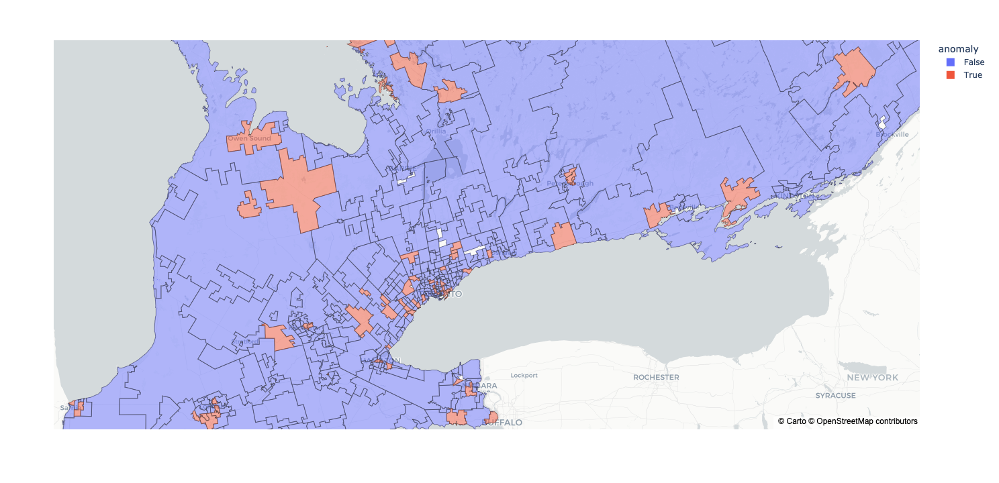

In [9]:
detector.graph()

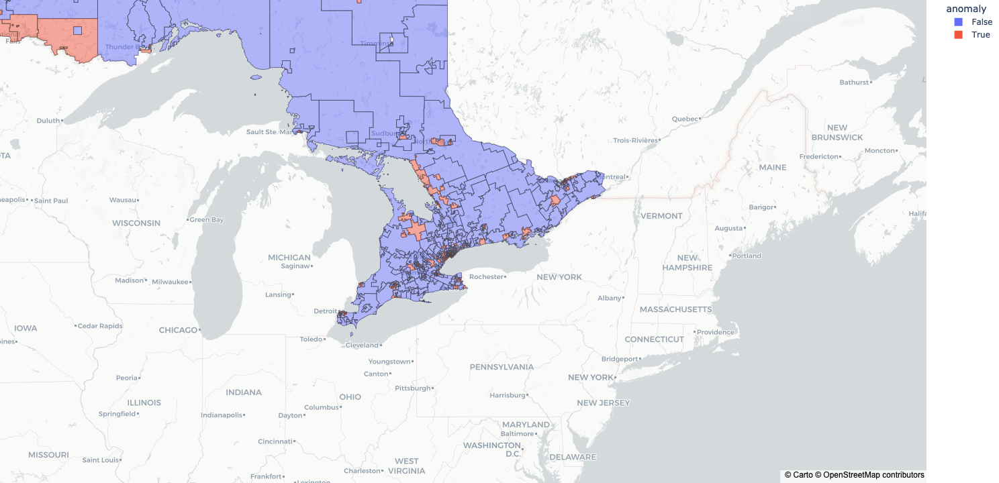

In [10]:
fig = detector.graph(zoom=5)
fig.update_layout(margin={"r": 0, "t": 0, "l": 0, "b": 0})
fig.show()

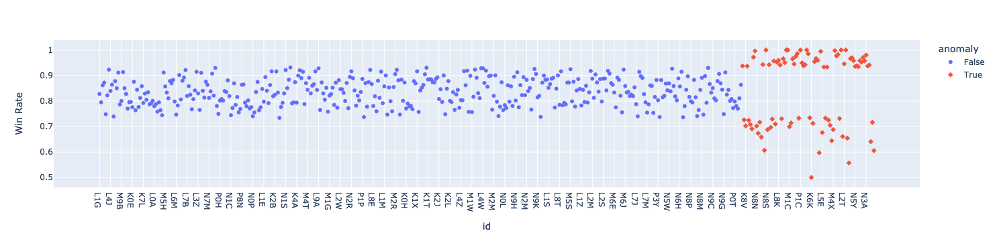

In [11]:
detector.graph(no_geo=True)